<a href="https://colab.research.google.com/github/Saijyothi17/Face-detection-and-Face-recognition-in-aerial-drone-imagery/blob/main/mini124.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
import tensorflow as tf
from tensorflow.keras.layers import Input, Conv2D, Flatten, Dense, BatchNormalization, MaxPooling2D, ReLU
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# Define the model architecture
def create_facenet_model(input_shape=(224, 224, 3)):
    input_layer = Input(shape=input_shape)
    x = Conv2D(filters=64, kernel_size=3, padding='same', name='conv1')(input_layer)
    x = BatchNormalization(name='bn1')(x)
    x = ReLU(name='relu1')(x)
    x = MaxPooling2D(pool_size=2, strides=2, name='pool1')(x)

    x = Conv2D(filters=128, kernel_size=3, padding='same', name='conv2')(x)
    x = BatchNormalization(name='bn2')(x)
    x = ReLU(name='relu2')(x)
    x = MaxPooling2D(pool_size=2, strides=2, name='pool2')(x)

    x = Conv2D(filters=256, kernel_size=3, padding='same', name='conv3')(x)
    x = BatchNormalization(name='bn3')(x)
    x = ReLU(name='relu3')(x)
    x = MaxPooling2D(pool_size=2, strides=2, name='pool3')(x)

    x = Conv2D(filters=512, kernel_size=3, padding='same', name='conv4')(x)
    x = BatchNormalization(name='bn4')(x)
    x = ReLU(name='relu4')(x)

    x = Flatten(name='flatten')(x)
    x = Dense(units=256, name='fc1')(x)
    x = BatchNormalization(name='bn5')(x)
    x = ReLU(name='relu5')(x)

    x = Dense(units=128, name='fc2')(x)
    x = BatchNormalization(name='bn6')(x)
    output_layer = ReLU(name='output')(x)

    model = Model(inputs=input_layer, outputs=output_layer, name='facenet')
    return model

# Define the loss function for training the model
def triplet_loss(y_true, y_pred, alpha=0.2):
    anchor, positive, negative = y_pred[0], y_pred[1], y_pred[2]
    positive_distance = tf.reduce_sum(tf.square(tf.subtract(anchor, positive)), axis=-1)
    negative_distance = tf.reduce_sum(tf.square(tf.subtract(anchor, negative)), axis=-1)
    loss = tf.maximum(positive_distance - negative_distance + alpha, 0.0)
    return tf.reduce_mean(loss)

# Create the FaceNet model
facenet_model = create_facenet_model()

# Compile the model with the triplet loss function and Adam optimizer
facenet_model.compile(loss=triplet_loss, optimizer=Adam(learning_rate=0.001))

# Create an ImageDataGenerator for data augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.1, height_shift_range=0.1, shear_range=0.2, zoom_range=0.2, horizontal_flip=True)

# Load the training data using the ImageDataGenerator
train_generator = datagen.flow_from_directory(directory='/content/gdrive/MyDrive/known_faces/dataset', target_size=(224, 224), batch_size=32)

# Define early stopping to


Found 1364 images belonging to 12 classes.


In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=5)

In [ ]:
facenet_model.fit(train_generator, epochs=10, callbacks=[early_stopping])



Epoch 1/10
43/43 [==============================] - ETA: 0s - loss: 12.5529 

43/43 [==============================] - 502s 12s/step - loss: 12.5529
Epoch 2/10
43/43 [==============================] - ETA: 0s - loss: 10.9958 

43/43 [==============================] - 498s 12s/step - loss: 10.9958
Epoch 3/10
43/43 [==============================] - ETA: 0s - loss: 14.5061 

43/43 [==============================] - 501s 12s/step - loss: 14.5061
Epoch 4/10
43/43 [==============================] - ETA: 0s - loss: 8.5571 

43/43 [==============================] - 500s 12s/step - loss: 8.5571
Epoch 5/10
43/43 [==============================] - ETA: 0s - loss: 6.6750 

43/43 [==============================] - 502s 12s/step - loss: 6.6750
Epoch 6/10
43/43 [==============================] - ETA: 0s - loss: 7.1761 

43/43 [==============================] - 500s 12s/step - loss: 7.1761
Epoch 7/10
43/43 [==============================] - ETA: 0s - loss: 8.3559 

43/43 [==============================] - 498s 12s/step - loss: 8.3559
Epoch 8/10
43/43 [==============================] - ETA: 0s - loss: 8.1049 

43/43 [==============================] - 496s 12s/step - loss: 8.1049
Epoch 9/10
43/43 [==============================] - ETA: 0s - loss: 7.5451 

43/43 [==============================] - 495s 11s/step - loss: 7.5451
Epoch 10/10
43/43 [==============================] - ETA: 0s - loss: 6.0672 

43/43 [==============================] - 497s 12s/step - loss: 6.0672


In [ ]:
facenet_model.save_weights('/content/gdrive/MyDrive/known_faces/facenet_weights.h5')

In [ ]:
pip install mtcnn

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 30.1 MB/s eta 0:00:00


In [ ]:
from imutils import face_utils
from google.colab.patches import cv2_imshow

In [ ]:
import os
import cv2
import numpy as np
from imutils import paths

# Load the trained weights
facenet_model.load_weights('/content/gdrive/MyDrive/known_faces/facenet_weights.h5')

# Define a function to extract face embeddings using the FaceNet model
def extract_face_embeddings(image_path):
    image = cv2.imread(image_path)
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    image = cv2.resize(image, (224, 224))
    image = np.expand_dims(image, axis=0)
    embeddings = facenet_model.predict(image)[0]
    return embeddings


In [ ]:
import cv2
from google.colab.patches import cv2_imshow
from mtcnn import MTCNN
known_embeddings = []
known_labels = []
for label in os.listdir('/content/gdrive/MyDrive/known_faces/dataset'):


  folder_path = os.path.join('/content/gdrive/MyDrive/known_faces/dataset', label)
  for image_path in os.listdir(folder_path):


    image_path = os.path.join(folder_path, image_path)
    embedding = extract_face_embeddings(image_path)
    known_embeddings.append(embedding)
    known_labels.append(label)

known_embeddings = np.array(known_embeddings)
known_labels = np.array(known_labels)

!pip install ipywidgets --upgrade
from PIL import Image
from google.colab import files
from PIL import Image
import matplotlib.pyplot as plt


1/1 [==============================] - 0s 183ms/step
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:

++from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
predicted_labels = []
known_labels1= []
for label in os.listdir('/content/gdrive/MyDrive/known_faces/dataset'):
  folder_path = os.path.join('/content/gdrive/MyDrive/known_faces/dataset', label)
  for image_path in os.listdir(folder_path):
    image_path = os.path.join(folder_path, image_path)
    embedding = extract_face_embeddings(image_path)
    known_labels1.append(label)
   # distance = np.linalg.norm(known_embeddings - embedding, axis=1)
    #min_distance_idx1 = np.argmin(distance)
    #label1 = known_labels[min_distance_idx1]
    # Get the label of the known face embedding with the smallest distance to the testing face embedding
    #predicted_labels.append(label1)



1/1 [==============================] - 0s 283ms/step


Saving test1.JPG to test1.JPG


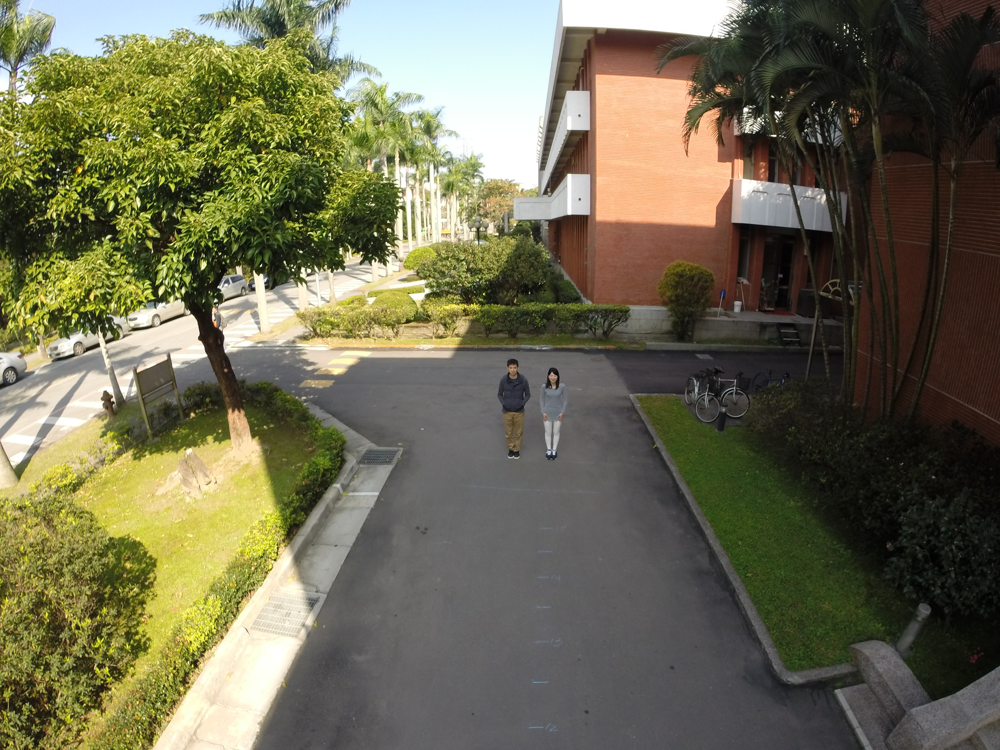

1/1 [==============================] - 0s 335ms/step
[7.4505353 7.7207294 7.413303  ... 3.417112  3.471633  4.9677243]
1/1 [==============================] - 0s 394ms/step
[4.7300696 4.9657044 4.5529137 ... 5.19566   5.1975093 5.1631083]


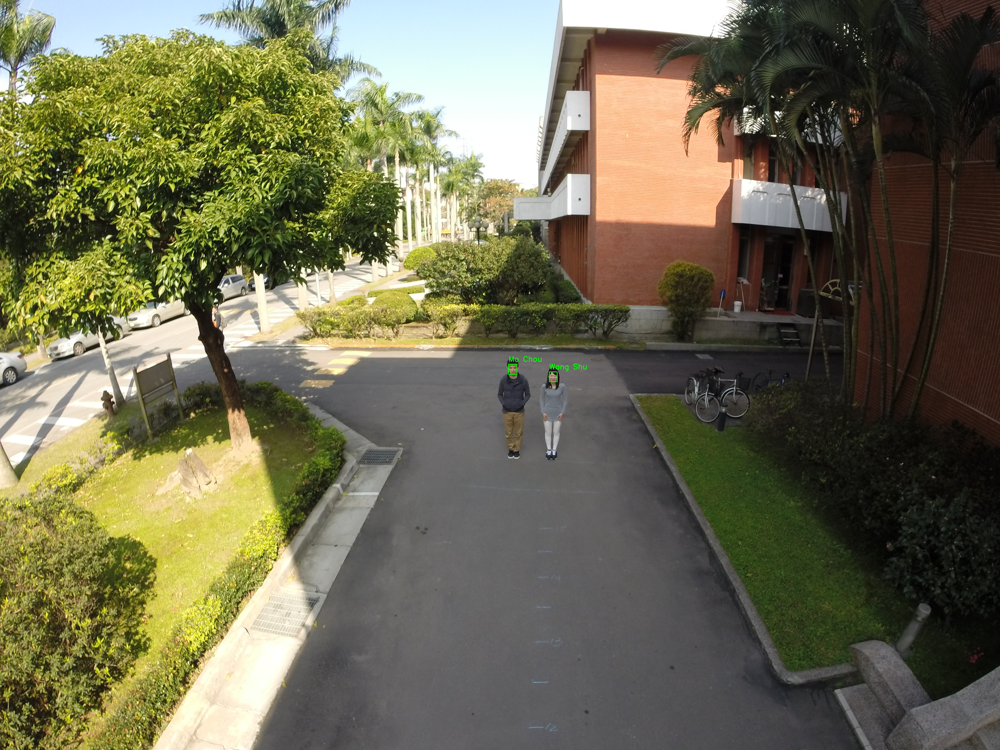

In [ ]:
from IPython.display import HTML, display, Image
# Set the background color of the entire notebook
display(HTML("<style>body { background-color:  turquoise !important; }</style>"))
# Display the text
display(HTML("<h1 style='color: black; font-family: Lobster; font-size: 36px; font-weight: bold; text-decoration: underline;'>Upload test image</h1>"))
uploaded_file = files.upload()
# Get the name of the uploaded file
filename = list(uploaded_file.keys())[0]

# Save the uploaded file as a JPEG image
with open('uploaded_image.jpg', 'wb') as f:
    f.write(uploaded_file[filename])
from IPython.display import Image

# Display the JPEG image
Image(filename='uploaded_image.jpg')
# Load the image
import cv2
from google.colab import files
from IPython.display import Image, display
# Display the uploaded image and the output in separate boxes
display(HTML("<h1 style='color: black; font-family:Lobster; font-size: 36px; font-weight: bold; text-decoration: underline;'>uploaded image</h1>"))
display(Image('uploaded_image.jpg', width=200))
image = cv2.imread('uploaded_image.jpg')
# Initialize MTCNN
detector = MTCNN()
# Detect faces in the image
faces = detector.detect_faces(image)
# Draw bounding boxes around each face
for face in faces:
    (x, y, w, h) = face['box']
    face_image = image[y:y+h, x:x+w]
    cv2.imwrite("/content/gdrive/MyDrive/known_faces/tempface.jpg", face_image)
    face_embedding = extract_face_embeddings("/content/gdrive/MyDrive/known_faces/tempface.jpg")
    distances = np.linalg.norm(known_embeddings - face_embedding, axis=1)
    min_distance_idx = np.argmin(distances)
    label = known_labels[min_distance_idx]
    print(distances)
    cv2.rectangle(image, (x, y), (x+w, y+h), (0, 255, 0), 2)
    cv2.putText(image, label, (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (0, 255, 0), 2)



display(HTML("<h1 style='color: black; font-family: Lobster; font-size: 36px; font-weight: bold; text-decoration: underline;'>Output</h1>"))
# Show the image with bounding boxes
resized_image = cv2.resize(image, (0,0), fx=1, fy=1)
cv2_imshow( image)
cv2.waitKey(0)
cv2.destroyAllWindows()

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall

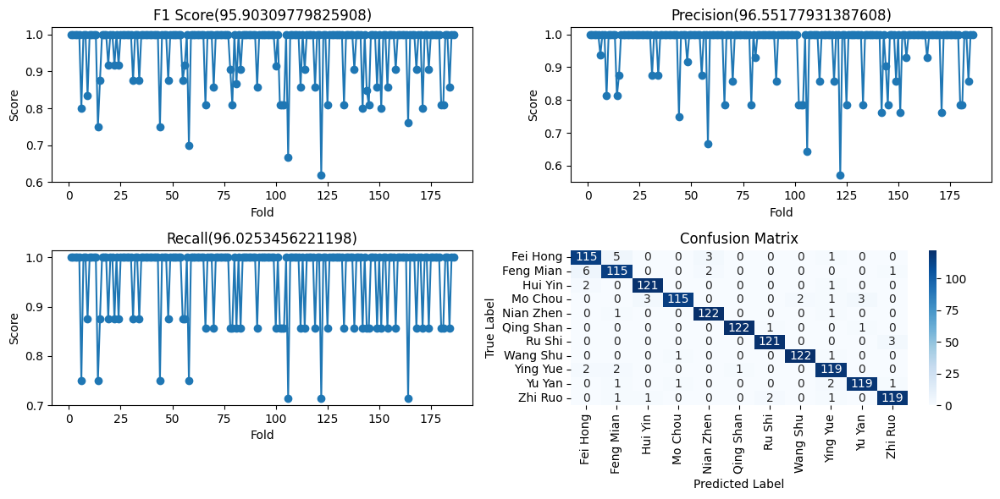

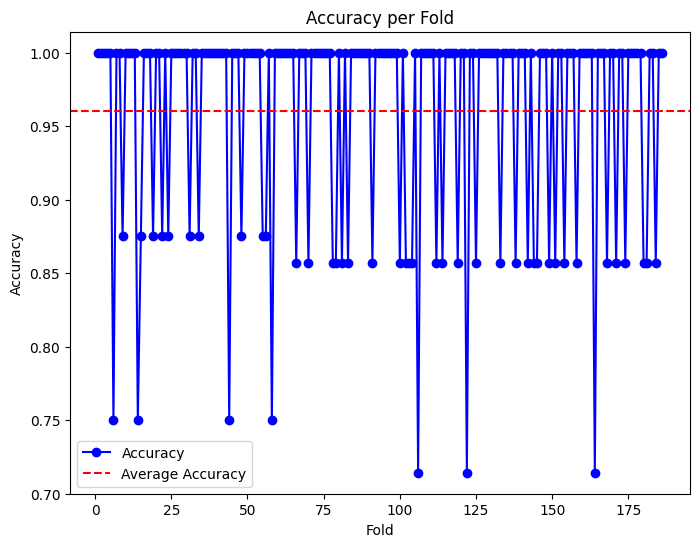

Average Accuracy: 96.0253456221198
Average Precision: 96.55177931387608
Average Recall: 96.0253456221198
Average F1-score: 95.90309779825908


In [ ]:
# Initialize metrics lists
from sklearn.model_selection import KFold
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, auc, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
# Initialize metrics lists
accuracy_scores = []
precision_scores = []
recall_scores = []
f1_scores = []
mean_fpr = np.linspace(0, 1, 100)
tprs = []
cm_sum = np.zeros((len(np.unique(known_labels)), len(np.unique(known_labels))))

# Perform k-fold cross-validation
n_splits = 186
kf = KFold(n_splits=n_splits, shuffle=True, random_state=42)

plt.figure(figsize=(12, 6))


for i, (train_index, test_index) in enumerate(kf.split(known_embeddings)):
    X_train, X_test = known_embeddings[train_index], known_embeddings[test_index]
    y_train, y_test = known_labels[train_index], known_labels[test_index]

    predicted_labels = []

    # Perform face recognition on test set
    for embedding in X_test:
        distances = np.linalg.norm(X_train - embedding, axis=1)
        min_distance_idx1 = np.argmin(distances)
        label1 = y_train[min_distance_idx1]
        predicted_labels.append(label1)

    accuracy = accuracy_score(y_test, predicted_labels)
    precision = precision_score(y_test, predicted_labels, average='weighted')
    recall = recall_score(y_test, predicted_labels, average='weighted')
    f1 = f1_score(y_test, predicted_labels, average='weighted')

    accuracy_scores.append(accuracy)
    precision_scores.append(precision)
    recall_scores.append(recall)
    f1_scores.append(f1)
    # Update confusion matrix
    cm = confusion_matrix(y_test, predicted_labels, labels=np.unique(known_labels))
    cm_sum += cm

# Calculate the average of metrics over all splits
average_accuracy = np.mean(accuracy_scores)
average_precision = np.mean(precision_scores)
average_recall = np.mean(recall_scores)
average_f1 = np.mean(f1_scores)
# Plot F1 score
plt.subplot(2, 2, 1)
plt.plot(range(1, n_splits+1), f1_scores, marker='o')
plt.title('F1 Score'+"("+str(average_f1*100)+')')
plt.xlabel('Fold')
plt.ylabel('Score')

# Plot precision
plt.subplot(2, 2, 2)
plt.plot(range(1, n_splits+1), precision_scores, marker='o')
plt.title('Precision'+"("+str(average_precision*100)+')')
plt.xlabel('Fold')
plt.ylabel('Score')

# Plot recall
plt.subplot(2, 2, 3)
plt.plot(range(1, n_splits+1), recall_scores, marker='o')
plt.title('Recall'+"("+str(average_recall*100)+')')
plt.xlabel('Fold')
plt.ylabel('Score')

# Plot confusion matrix
plt.subplot(2, 2, 4)
sns.heatmap(cm_sum, annot=True, cmap='Blues', fmt='g', xticklabels=np.unique(known_labels), yticklabels=np.unique(known_labels))
plt.title('Confusion Matrix')
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

plt.tight_layout()

# Plot the accuracy graph
plt.figure(figsize=(8, 6))
plt.plot(range(1, n_splits + 1), accuracy_scores, 'bo-', label='Accuracy')
plt.axhline(y=average_accuracy, color='r', linestyle='--', label='Average Accuracy')
plt.xlabel('Fold')
plt.ylabel('Accuracy')
plt.title('Accuracy per Fold')
plt.legend()
plt.show()

# Print the average metrics
print('Average Accuracy:', average_accuracy*100)
print('Average Precision:', average_precision*100)
print('Average Recall:', average_recall*100)
print('Average F1-score:', average_f1*100)

In [ ]:
!pip install ipywidgets --upgrade
from PIL import Image
from google.colab import files
from PIL import Image
!pip install --upgrade Pillow

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 138.3/138.3 kB 6.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 50.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 81.2 MB/s eta 0:00:00
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.4
    Uninstalling widgetsnbextension-3.6.4:
      Successfully uninstalled widgetsnbextension-3.6.4
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.4/3.4 MB 46.6 MB/s eta 0:00:00
  Attempting uninstall: Pillow
    Found existing installation: Pillow 8.4.0
    Uninstalling Pillow-8.4.0:
      Su